# Back-testing + output predicted spreads and their statistical properties



# Modules

In [3]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import pandas as pd
import glob
from scipy.stats import pearsonr

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.float_format', '{:.20f}'.format)

from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
import re
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
import statistics


from datetime import datetime, timedelta
import warnings
import numpy as np
import random
from statsmodels.tsa.stattools import adfuller, coint, acf
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

import warnings
warnings.filterwarnings('ignore')



In [4]:
from google.colab import drive
import os
import shutil

# Mount Google Drive
drive.mount('/content/drive')


Mounted at /content/drive


In [16]:
cd /content/drive/MyDrive/MSC_YORK/PROJECT/

/content/drive/MyDrive/MSC_YORK/PROJECT


In [17]:
pwd

'/content/drive/MyDrive/MSC_YORK/PROJECT'

# Create BACK-TESTING sub-folders

In [7]:

# Read the confirmed_cointegrated_pairs.csv file
cointegrated_pairs = pd.read_csv('MOST_COINTEGRATED_PAIRS/confirmed_cointegrated_pairs.csv')

# Extract the required information from each row
for index, row in cointegrated_pairs.iterrows():
    coin1 = row.coin1
    coin2 = row.coin2
    in_sample_start_date = row.in_sample_start_date
    in_sample_end_date = row.in_sample_end_date
    out_of_sample_end_date = row.out_of_sample_end_date
    print("READ CSV : ", coin1, coin2, in_sample_start_date, in_sample_end_date, out_of_sample_end_date)

    destination_folder_pattern = f'BACKTESTING/{coin1}_{coin2}_{in_sample_start_date}_{in_sample_end_date}_{out_of_sample_end_date}'

    # Check if the folder exists
    if not os.path.exists(destination_folder_pattern):
        # Create the folder
        os.makedirs(destination_folder_pattern)


READ CSV :  BTCUSDT LUNCUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  ETHUSDT XRPUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  ETHUSDT SHIBUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  ETHUSDT MATICUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  ETHUSDT DOTUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  SOLUSDT SANDUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  SOLUSDT DOTUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT LTCUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT MATICUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT SANDUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT TRXUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT LUNCUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  XRPUSDT ATOMUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  DOGEUSDT LINKUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  SHIBUSDT SANDUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV :  LTCUSDT LUNCUSDT 2023-01-01 2023-01-19 2023-01-23
READ CSV 

# Back-testing

In [ ]:
from pickle import NONE
class SpreadPrediction:
    """
    A class used to predict and analyse the spread between two cryptocurrencies.

    Attributes:
    ----------
    file1, file2, file3, file4, file5 : str
        Paths to the CSV files containing data for analysis.
    beta, alpha : float
        Parameters for spread calculation.
    window : int
        Parameters for rolling window size.
    standard_threshold, high_threshold : float
        Thresholds for trading signals based on spread.
    initial_capital : float
        Initial capital for trading simulation.
    entry_volume_ratio, cost_ratio : float
        Ratios for entry volume and transaction costs.
    risk_free_rate : float
        Risk-free rate for Sharpe ratio calculation.
    window_d, exit_score, delay : int
        Additional parameters for trading strategy.
    in_sample_start_date, in_sample_end_date, out_of_sample_end_date : str
        Dates defining the in-sample and out-of-sample periods.
    """
    def __init__(self, file1, file2, file3, file4, file5,
                 beta, alpha,
                 window,standard_threshold, high_threshold,
                 initial_capital,entry_volume_ratio,cost_ratio,risk_free_rate, window_d, exit_score, delay,
                 in_sample_start_date,in_sample_end_date, out_of_sample_end_date  ):
        """
        Initialize with file paths and parameters for spread calculation.

        Parameters:
        ----------
        file1, file2, file3, file4, file5 : str
            Paths to the CSV files.
        beta, alpha : float
            Parameters for spread calculation.
        window : int
            Parameters for rolling window size.
        standard_threshold, high_threshold : float
            Thresholds for trading signals based on spread.
        initial_capital : float
            Initial capital for trading simulation.
        entry_volume_ratio, cost_ratio : float
            Ratios for entry volume and transaction costs.
        risk_free_rate : float
            Risk-free rate for Sharpe ratio calculation.
        window_d, exit_score, delay : int
            Additional parameters for trading strategy.
        in_sample_start_date, in_sample_end_date, out_of_sample_end_date : str
            Dates defining the in-sample and out-of-sample periods.
        """
        self.file1 = file1
        self.file2 = file2
        self.file3 = file3
        self.file4 = file4
        self.file5 = file5
        self.beta = beta
        self.alpha = alpha
        self.ai_algo_trading_signals = None
        self.standard_algo_trading_signals = None
        self.coin1 = self.extract_coin_name(file1)
        self.coin2 = self.extract_coin_name(file2)
        self.window = window
        self.standard_threshold = standard_threshold
        self.high_threshold = high_threshold
        self.initial_capital = initial_capital
        self.capital_per_asset = initial_capital / 2
        self.entry_volume_ratio = entry_volume_ratio
        self.cost_ratio = cost_ratio
        self.risk_free_rate = risk_free_rate  # Assuming a risk-free rate of 1% per annum
        self.portfolio = {}
        self.window_minutes = int(window_d*24*60)
        self.exit_score = exit_score
        self.delay = delay
        self.in_sample_start_date = in_sample_start_date
        self.in_sample_end_date = in_sample_end_date
        self.out_of_sample_end_date = out_of_sample_end_date
        print(self.window_minutes)

    def extract_coin_name(self, file_path):
        """
        Extract the coin name from the file path.

        Parameters:
        ----------
        file_path : str
            The file path to extract the coin name from.

        Returns:
        -------
        str
            The extracted coin name.
        """
        # Extract the coin name from the file path using regex
        match = re.search(r'transformers_predictions_(\w+)_\d{4}-\d{2}-\d{2}_\d{4}-\d{2}-\d{2}\.csv', file_path)
        if match:
            return match.group(1)
        else:
            raise ValueError(f"Could not extract coin name from file path: {file_path}")

    def load_data(self):
        """
        Load data from CSV files and merge based on close_time, with prediction times shifted.
        """
        self.df1 = pd.read_csv(self.file1)
        self.df2 = pd.read_csv(self.file2)

        self.df3 = pd.read_csv(self.file3)
        self.df3 = self.df3[['close_time', 'spread']]
        self.df3.columns = ['close_time']+['historical_'+col for col in self.df3.columns if 'close_time' not in col]

        self.df4 = pd.read_csv(self.file4)
        self.df4 = self.df4[['close_time',f'{self.coin1}_mid',f'{self.coin1}_vol']]
        self.df4.columns = ['close_time']+['historical_'+col for col in self.df4.columns if 'close_time' not in col]

        self.df5 = pd.read_csv(self.file5)
        self.df5 = self.df5[['close_time',f'{self.coin2}_mid',f'{self.coin2}_vol']]
        self.df5.columns = ['close_time']+['historical_'+col for col in self.df5.columns if 'close_time' not in col]

        # Merging data on close_time
        self.ai_algo_trading_signals = pd.merge(self.df1, self.df2, how = 'left', on='close_time', suffixes=(f'_{self.coin1}', f'_{self.coin2}'))
        self.ai_algo_trading_signals['close_time'] = pd.to_datetime(self.ai_algo_trading_signals['close_time'])
        self.df3['close_time'] = pd.to_datetime(self.df3['close_time'])
        self.df4['close_time'] = pd.to_datetime(self.df4['close_time'])
        self.df5['close_time'] = pd.to_datetime(self.df5['close_time'])

        print(f"self.df1.close_time.min() : {self.df1.close_time.min()} ")
        print(f"self.df2.close_time.min() : {self.df2.close_time.min()} ")
        print(f"self.df3.close_time.min() : {self.df3.close_time.min()} ")
        print(f"self.df4.close_time.min() : {self.df4.close_time.min()} ")
        print(f"self.df5.close_time.min() : {self.df5.close_time.min()} ")
        print(f"self.ai_algo_trading_signals.close_time.min() : {self.df1.close_time.min()} ")

    def calculate_log_prices(self):
        """
        Calculate the logarithm of the prices in the merged data.
        """
        self.ai_algo_trading_signals[f'log_actual_price_{self.coin1}'] = np.log(self.ai_algo_trading_signals[f'actual_{self.coin1}'])
        self.ai_algo_trading_signals[f'log_prediction_{self.coin1}'] = np.log(self.ai_algo_trading_signals[f'predictions_{self.coin1}'])
        self.ai_algo_trading_signals[f'log_actual_price_{self.coin2}'] = np.log(self.ai_algo_trading_signals[f'actual_{self.coin2}'])
        self.ai_algo_trading_signals[f'log_prediction_{self.coin2}'] = np.log(self.ai_algo_trading_signals[f'predictions_{self.coin2}'])

    def calculate_predicted_and_actual_spread(self):
        """
        Calculate the predicted spread using the given beta and alpha.
        """
        self.ai_algo_trading_signals['predicted_spread'] = self.ai_algo_trading_signals[f'log_prediction_{self.coin1}'] - (self.alpha + self.beta * (self.ai_algo_trading_signals[f'log_prediction_{self.coin2}']) )
        self.ai_algo_trading_signals['actual_spread'] = self.ai_algo_trading_signals[f'log_actual_price_{self.coin1}'] - (self.alpha + self.beta * (self.ai_algo_trading_signals[f'log_actual_price_{self.coin2}']) )

    def calculate_predicted_spread_rolling_z_score(self, ):
        """
        Calculate the rolling mean and standard deviation for the actual spread.
        """

        # Initialize lists to store the rolling mean and sd
        rolling_mean_list = []
        rolling_sd_list = []
        predicted_rolling_mean_list = []
        predicted_rolling_sd_list = []



        # Iterate over each row in df1
        for index, row in self.ai_algo_trading_signals.iterrows():
            close_time_t = row['close_time']
            predicted_spread_t = row['predicted_spread']

            # Get last n entries from df3 where close_time <= close_time_t
            subset_df2 = self.df3[self.df3['close_time'] <= close_time_t].tail(self.window_minutes)

            # Get the spreads from the subset and add the predicted spread
            spreads = subset_df2['historical_spread'].tolist()
            spreads_including_predicted = spreads.copy()
            spreads_including_predicted.append(predicted_spread_t)#atn

            # Calculate mean and sd
            rolling_mean = np.mean(spreads)
            rolling_sd = np.std(spreads)
            predicted_rolling_mean = np.mean(spreads_including_predicted)
            predicted_rolling_sd = np.std(spreads_including_predicted)

            # Append to the lists
            rolling_mean_list.append(rolling_mean)
            rolling_sd_list.append(rolling_sd)
            predicted_rolling_mean_list.append(predicted_rolling_mean)#atn
            predicted_rolling_sd_list.append(predicted_rolling_sd)#atn

        # Add the new columns to df1
        self.ai_algo_trading_signals[f'actual_spread_rolling_mean_{self.window_minutes}_minutes'] = rolling_mean_list#atn
        self.ai_algo_trading_signals[f'actual_spread_rolling_sd_{self.window_minutes}_minutes'] = rolling_sd_list#atn
        self.ai_algo_trading_signals[f'predicted_spread_rolling_mean_{self.window_minutes}_minutes'] = predicted_rolling_mean_list#atn
        self.ai_algo_trading_signals[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes']= predicted_rolling_sd_list#atn

        self.ai_algo_trading_signals[f'predicted_rolling_z_score_{self.window_minutes}_minutes'] = (self.ai_algo_trading_signals['predicted_spread'] - self.ai_algo_trading_signals[f'predicted_spread_rolling_mean_{self.window_minutes}_minutes']) / self.ai_algo_trading_signals[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes']
        self.ai_algo_trading_signals[f'actual_rolling_z_score_{self.window_minutes}_minutes'] = (self.ai_algo_trading_signals['actual_spread'] - self.ai_algo_trading_signals[f'actual_spread_rolling_mean_{self.window_minutes}_minutes']) / self.ai_algo_trading_signals[f'actual_spread_rolling_sd_{self.window_minutes}_minutes']
        self.ai_algo_trading_signals[f'actual_rolling_z_score_{self.window_minutes}_minutes_lag_1'] = self.ai_algo_trading_signals[f'actual_rolling_z_score_{self.window_minutes}_minutes'].shift(1).\
            fillna(0)#atn
        # Calculate 75th percentile of the rolling SD of the spread
        self.ai_algo_trading_signals[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes_percentile_75th'] =\
            self.ai_algo_trading_signals[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes'].rolling(self.window,min_periods=1).quantile(0.75).bfill()
        # self.ai_algo_trading_signals = self.ai_algo_trading_signals.dropna()


    def evaluate_and_plot_predicted_and_actual_spread(self):
        """
        Evaluate the predicted spread against the actual spread and plot the results.
        """
        # Metrics calculation
        self.rmse = np.sqrt(mean_squared_error(self.ai_algo_trading_signals.dropna()['actual_spread'], self.ai_algo_trading_signals.dropna()['predicted_spread']))
        self.mse = mean_squared_error(self.ai_algo_trading_signals.dropna()['actual_spread'], self.ai_algo_trading_signals.dropna()['predicted_spread'])
        self.mae = mean_absolute_error(self.ai_algo_trading_signals.dropna()['actual_spread'], self.ai_algo_trading_signals.dropna()['predicted_spread'])

        self.r2 = r2_score(self.ai_algo_trading_signals.dropna()['actual_spread'], self.ai_algo_trading_signals.dropna()['predicted_spread'])
        self.mape = mean_absolute_percentage_error(self.ai_algo_trading_signals.dropna()['actual_spread'], self.ai_algo_trading_signals.dropna()['predicted_spread'])


        # Print metrics
        print(f"RMSE: {self.rmse}")
        print(f"MSE: {self.mse}")
        print(f"MAE: {self.mae}")
        print(f"R²: {self.r2}")
        print(f"MAPE: {self.mape}")

        # Plotting
        self.ai_algo_trading_signals['close_time'] = pd.to_datetime(self.ai_algo_trading_signals['close_time'])
        plt.figure(figsize=(20, 10))
        plt.plot(self.ai_algo_trading_signals['close_time'][:], self.ai_algo_trading_signals['actual_spread'][:], label='Actual Spread')
        plt.plot(self.ai_algo_trading_signals['close_time'][:], self.ai_algo_trading_signals['predicted_spread'][:], label='Predicted Spread')

        ax = plt.gca()
        ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d %H:%M:%S'))
        ax.xaxis.set_major_locator(mdates.AutoDateLocator())
        plt.xlabel('Time')
        plt.ylabel('Spread')
        plt.title(f'{self.coin1}-{self.coin2}_Actual vs Predicted Spread')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.savefig(f'SPREADS/PREDICTED/PREDICTED_VS_ACTUAL_SPREAD_{self.coin1}_{self.coin2}_{self.in_sample_end_date}_{self.out_of_sample_end_date}_plot.png')

        # plt.show()


    def add_historical_spread_rolling_z_score(self):
        """
        Calculate the actual spread rolling z score
        """
        self.ai_algo_trading_signals = self.ai_algo_trading_signals.merge(self.df3, how = 'left', on = ['close_time'] )

    def add_historical_mid_prices(self):
        """
        Calculate the actual spread rolling z score
        """
        self.ai_algo_trading_signals = self.ai_algo_trading_signals.merge(self.df4, how = 'left', on = ['close_time'])
        self.ai_algo_trading_signals = self.ai_algo_trading_signals.merge(self.df5, how = 'left', on = ['close_time'])

        self.standard_algo_trading_signals = self.df3[self.df3.close_time >= self.ai_algo_trading_signals.close_time.min()].merge(self.df4, how = 'left', on = ['close_time'])
        self.standard_algo_trading_signals = self.standard_algo_trading_signals.merge(self.df5, how = 'left', on = ['close_time'])

        print(f"self.ai_algo_trading_signals.close_time.min() : {self.ai_algo_trading_signals.close_time.min()} ")
        print(f"self.standard_algo_trading_signals.close_time.min() : {self.standard_algo_trading_signals.close_time.min()} ")


    def calculate_rolling_statistics_on_historical_spread(self):
        """
        Calculate rolling mean and standard deviation on historical spread.
        """

        # Initialize lists to store the rolling mean and sd
        rolling_mean_list = []
        rolling_sd_list = []

        # Iterate over each row in df1
        for index, row in self.standard_algo_trading_signals.iterrows():
            close_time_t = row['close_time']
            predicted_spread_t = row['historical_spread']

            # Get last n entries from df3 where close_time <= close_time_t
            subset_df2 = self.df3[self.df3['close_time'] <= close_time_t].tail(self.window_minutes)

            # Get the spreads from the subset and add the predicted spread
            spreads = subset_df2['historical_spread'].tolist()


            # Calculate mean and sd
            rolling_mean = np.mean(spreads)
            rolling_sd = np.std(spreads)


            # Append to the lists
            rolling_mean_list.append(rolling_mean)
            rolling_sd_list.append(rolling_sd)


        self.standard_algo_trading_signals[f'historical_rolling_mean_{self.window_minutes}_minutes'] = rolling_mean_list
        self.standard_algo_trading_signals[f'historical_rolling_sd_{self.window_minutes}_minutes'] = rolling_sd_list
        self.standard_algo_trading_signals[f'historical_rolling_z_score_{self.window_minutes}_minutes'] = (self.standard_algo_trading_signals['historical_spread'] - self.standard_algo_trading_signals[f'historical_rolling_mean_{self.window_minutes}_minutes'])/self.standard_algo_trading_signals[f'historical_rolling_sd_{self.window_minutes}_minutes']
        self.standard_algo_trading_signals[f'historical_rolling_z_score_{self.window_minutes}_minutes_lag_1']= self.standard_algo_trading_signals[f'historical_rolling_z_score_{self.window_minutes}_minutes'].shift(1).\
            fillna(0)

    def add_historical_rolling_sd_percentile_75th(self, ):
        """
        Calculate the 75th percentile of the rolling standard deviation for historical spread.
        """

        self.standard_algo_trading_signals[f'rolling_sd_{self.window_minutes}_minutes']= self.standard_algo_trading_signals['historical_spread'].rolling(self.window_minutes, min_periods=1).std()
        self.standard_algo_trading_signals[f'algo_trading_rolling_sd_{self.window_minutes}_minutes_percentile_75th'] =\
            self.standard_algo_trading_signals[f'rolling_sd_{self.window_minutes}_minutes'].rolling(self.window,min_periods=1).quantile(0.75).bfill()

    def generate_trading_signals_for_predicted_spread(self,):
        """
        Generate trading signals based on the predicted spread and rolling z-score.
        """
        signals = []
        thresholds = []

        for index, row in self.ai_algo_trading_signals.iterrows():
            # Determine the z-score threshold based on volatility
            threshold = self.standard_threshold
            if row[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes'] > row[f'predicted_spread_rolling_sd_{self.window_minutes}_minutes_percentile_75th']:
                #in case of high volatility
                threshold = self.high_threshold

            thresholds.append(threshold)
            exit_score = self.exit_score

            predicted_z_score_spread = row[f'predicted_rolling_z_score_{self.window_minutes}_minutes']
            actual_z_score_spread_lag_1 = row[f'actual_rolling_z_score_{self.window_minutes}_minutes_lag_1']
            actual_z_score_spread = row[f'actual_rolling_z_score_{self.window_minutes}_minutes']#atn

            if predicted_z_score_spread > threshold and actual_z_score_spread < threshold:
                signals.append(1)  # Enter short position signal
            elif predicted_z_score_spread < -threshold and actual_z_score_spread > -threshold:
                signals.append(2)  # Enter long position signal
            elif actual_z_score_spread < exit_score and actual_z_score_spread_lag_1 > exit_score:
                signals.append(3)  # Exit short position signal
            elif actual_z_score_spread > exit_score and actual_z_score_spread_lag_1 < exit_score:
                signals.append(4)  # Exit long position signal
            else:
                signals.append(0)  # No new signal

        # Process delays in signals
        opening_signals = [signal if signal in [1, 2] else 0 for signal in signals]
        closing_signals = [signal if signal in [3, 4] else 0 for signal in signals ]
        delayed_opening_signals = [0]*self.delay + opening_signals[:-self.delay]
        delayed_closing_signals = [0] + closing_signals[:-1]
        combined_delayed_signals = [max(open, close) for open, close in zip(delayed_opening_signals, delayed_closing_signals)]

        # Add signals to DataFrame
        self.ai_algo_trading_signals[f'signal_{self.window_minutes}_minutes'] = signals
        self.ai_algo_trading_signals[f'threshold_{self.window_minutes}_minutes'] = thresholds
        self.ai_algo_trading_signals[f'delayed_signal_{self.window_minutes}_minutes'] = combined_delayed_signals

    def generate_trading_signals_for_historical_spread(self,):
        """
        Generate trading signals based on the historical spread and rolling z-score.
        """
        signals = []
        thresholds = []

        for index, row in self.standard_algo_trading_signals.iterrows():
            # Determine the z-score threshold based on volatility
            threshold = self.standard_threshold
            if row[f'rolling_sd_{self.window_minutes}_minutes'] > row[f'algo_trading_rolling_sd_{self.window_minutes}_minutes_percentile_75th']:
                #in case of high volatility
                threshold = self.high_threshold

            thresholds.append(threshold)
            exit_score = self.exit_score

            z_score_spread = row[f'historical_rolling_z_score_{self.window_minutes}_minutes']
            previous_z_score_spread = row[f'historical_rolling_z_score_{self.window_minutes}_minutes_lag_1']

            # Generate trading signals
            if z_score_spread > threshold and previous_z_score_spread < threshold:
                signals.append(1)  # Enter short position signal
            elif z_score_spread < -threshold and previous_z_score_spread > -threshold:
                signals.append(2)  # Enter long position signal
            elif z_score_spread < exit_score and previous_z_score_spread > exit_score:
                signals.append(3)  # Exit short position signal
            elif z_score_spread > exit_score and previous_z_score_spread < exit_score:
                signals.append(4)  # Exit long position signal
            else:
                signals.append(0)  # No new signal

        # Add signals to DataFrame
        self.standard_algo_trading_signals[f'signal_{self.window_minutes}_minutes'] = signals
        self.standard_algo_trading_signals[f'threshold_{self.window_minutes}_minutes'] = thresholds
        self.standard_algo_trading_signals[f'delayed_signal_{self.window_minutes}_minutes'] = self.standard_algo_trading_signals[f'signal_{self.window_minutes}_minutes'].shift(1).fillna(0)

    def execute_trades(self, df, algo_type):
        """
        Execute trades based on generated signals and calculate portfolio metrics.

        Parameters:
        ----------
        df : pandas.DataFrame
            The DataFrame containing trading signals and historical data.
        algo_type : str
            The type of algorithm being used (e.g., 'predicted' or 'historical').
        """
        self.metrics = {}

        if algo_type not in self.portfolio:
            self.portfolio[algo_type] = {}
        if self.window_minutes not in self.portfolio[algo_type]:
            self.portfolio[algo_type][self.window_minutes] =  {
            'index':[None],
            'close_time': [None],
            'transaction_id': [None],
            'positions': [None],
            f'{self.coin1}_units': [0],
            f'{self.coin2}_units': [0],
            f'entry_{self.coin1}_price': [None],
            f'entry_{self.coin2}_price': [None],
            f'historical_{self.coin1}_mid': [0],
            f'historical_{self.coin2}_mid': [0],
            f'historical_{self.coin1}_vol': [0],
            f'historical_{self.coin2}_vol': [0],
            'signal': [None],
            'portfolio_value': [self.initial_capital],
            f'{self.coin1}_raw_pnl': [0],
            f'{self.coin2}_raw_pnl': [0],
            f'{self.coin1}_cost': [0],
            f'{self.coin2}_cost': [0],
            'trade_duration': [0],
            'is_profitable_trade': [0],
            'is_new_transaction': [0]
        }
        trade_start = None

        for i in range(0, len(df)):
            row = df.iloc[i]
            close_time = row['close_time']
            index = row.name
            signal = row[f'delayed_signal_{self.window_minutes}_minutes']
            coin1_price = row[f'historical_{self.coin1}_mid']
            coin2_price = row[f'historical_{self.coin2}_mid']
            coin1_volume = row[f'historical_{self.coin1}_vol']
            coin2_volume = row[f'historical_{self.coin2}_vol']

            previous_position = self.portfolio[algo_type][self.window_minutes]['positions'][-1]
            entry_coin1_price = self.portfolio[algo_type][self.window_minutes][f'entry_{self.coin1}_price'][-1]
            entry_coin2_price = self.portfolio[algo_type][self.window_minutes][f'entry_{self.coin2}_price'][-1]
            previous_transaction_id = self.portfolio[algo_type][self.window_minutes]['transaction_id'][-1]
            new_transaction_id = previous_transaction_id

            # Default to carry forward previous values
            new_coin1_units = self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_units'][-1]
            new_coin2_units = self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_units'][-1]
            new_entry_coin1_price = entry_coin1_price
            new_entry_coin2_price = entry_coin2_price
            new_position = previous_position
            new_portfolio_value = self.portfolio[algo_type][self.window_minutes]['portfolio_value'][-1]
            previous_portfolio_value = self.portfolio[algo_type][self.window_minutes]['portfolio_value'][-1]
            new_coin1_raw_pnl = self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_raw_pnl'][-1]
            new_coin2_raw_pnl = self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_raw_pnl'][-1]
            new_coin1_cost = self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_cost'][-1]
            new_coin2_cost = self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_cost'][-1]

            trade_duration = 0
            is_new_transaction = 0
            is_profitable_trade = 0

            # Close existing position if needed
            if (previous_position == 'long' and (signal == 4)) :  # Close long, open short

                new_portfolio_value += (abs(new_coin1_units) * (coin1_price * (1 - self.cost_ratio)  - entry_coin1_price * (1 + self.cost_ratio) ) )  + \
                                       (abs(new_coin2_units) * (entry_coin2_price * (1 - self.cost_ratio) - coin2_price * (1 + self.cost_ratio) ) )

                new_coin1_raw_pnl = (abs(new_coin1_units) * (coin1_price   - entry_coin1_price  ) )
                new_coin2_raw_pnl = (abs(new_coin2_units) * (entry_coin2_price - coin2_price  ) )

                new_coin1_cost = (abs(new_coin1_units) * (coin1_price * ( - self.cost_ratio)  - entry_coin1_price *  self.cost_ratio ) )
                new_coin2_cost = (abs(new_coin2_units) * (entry_coin2_price * (- self.cost_ratio) - coin2_price * self.cost_ratio) )

                new_coin1_units = 0
                new_coin2_units = 0
                new_position = None
                new_entry_coin1_price = None
                new_entry_coin2_price = None
                performance = np.log(coin1_price / entry_coin1_price) - self.beta * np.log(coin2_price / entry_coin2_price) + 2 * np.log((1 - self.cost_ratio) / (1 + self.cost_ratio))
                performance = np.exp(performance) - 1

                if new_portfolio_value > previous_portfolio_value:
                    is_profitable_trade = 1
                else:
                    is_profitable_trade = 0

                trade_duration = i - trade_start if trade_start is not None else 0


            elif (previous_position == 'short' and (signal == 3)) :  # Close short, open long

                new_portfolio_value += (abs(new_coin1_units) * (entry_coin1_price * (1 - self.cost_ratio) - coin1_price * (1 + self.cost_ratio))) + \
                                       (abs(new_coin2_units) * (coin2_price * (1 - self.cost_ratio) - entry_coin2_price * (1 + self.cost_ratio)))

                new_coin1_raw_pnl = (abs(new_coin1_units) * (entry_coin1_price - coin1_price ))
                new_coin2_raw_pnl = (abs(new_coin2_units) * (coin2_price - entry_coin2_price ))

                new_coin1_cost = (abs(new_coin1_units) * (entry_coin1_price * (-self.cost_ratio) - coin1_price * self.cost_ratio))
                new_coin2_cost = (abs(new_coin2_units) * (coin2_price * (-self.cost_ratio) - entry_coin2_price * self.cost_ratio))

                new_coin1_units = 0
                new_coin2_units = 0
                new_position = None
                new_entry_coin1_price = None
                new_entry_coin2_price = None
                performance = np.log(coin1_price / entry_coin1_price) - self.beta * np.log(coin2_price / entry_coin2_price) + 2 * np.log((1 - self.cost_ratio) / (1 + self.cost_ratio))
                performance = np.exp(performance) - 1

                if new_portfolio_value > previous_portfolio_value:
                    is_profitable_trade = 1
                else:
                    is_profitable_trade = 0

                trade_duration = i - trade_start if trade_start is not None else 0

            # Open new position if needed
            if signal == 1:  # Short position signal (sell coin1, buy coin2)
                if previous_position != 'short':
                    if previous_transaction_id is None:
                        new_transaction_id = 1
                    else:
                        new_transaction_id = previous_transaction_id + 1

                    target_coin1_units = -(self.capital_per_asset / coin1_price)  # Short sell
                    target_coin2_units = (self.capital_per_asset / coin2_price) * self.beta  # Buy

                    # Adjust units based on volume constraints
                    max_coin1_units = min(abs(target_coin1_units), coin1_volume)
                    max_coin2_units = min(target_coin2_units, coin2_volume)

                    adjustment_factor = min(abs(max_coin1_units / target_coin1_units), abs(max_coin2_units / target_coin2_units))*entry_volume_ratio

                    new_coin1_units = adjustment_factor * target_coin1_units
                    new_coin2_units = adjustment_factor * target_coin2_units

                    new_position = 'short'
                    new_entry_coin1_price = coin1_price
                    new_entry_coin2_price = coin2_price

                    trade_start = i  # Mark trade start time

                    is_new_transaction = 1

            elif signal == 2:  # Long position signal (buy coin1, sell coin2)
                if previous_position != 'long':
                    if previous_transaction_id is None:
                        new_transaction_id = 1
                    else:
                        new_transaction_id = previous_transaction_id + 1

                    target_coin1_units = self.capital_per_asset / coin1_price  # Buy
                    target_coin2_units = -(self.capital_per_asset / coin2_price) * self.beta  # Short sell

                    # Adjust units based on volume constraints
                    max_coin1_units = min(target_coin1_units, coin1_volume)
                    max_coin2_units = min(abs(target_coin2_units), coin2_volume)

                    adjustment_factor = min(abs(max_coin1_units / target_coin1_units), abs(max_coin2_units / target_coin2_units))*entry_volume_ratio

                    new_coin1_units = adjustment_factor * target_coin1_units
                    new_coin2_units = adjustment_factor * target_coin2_units


                    new_position = 'long'
                    new_entry_coin1_price = coin1_price
                    new_entry_coin2_price = coin2_price

                    trade_start = i  # Mark trade start time

                    is_new_transaction = 1



            # Append new values to the portfolio
            self.portfolio[algo_type][self.window_minutes]['index'].append(index)
            self.portfolio[algo_type][self.window_minutes]['close_time'].append(close_time)
            self.portfolio[algo_type][self.window_minutes]['transaction_id'].append(new_transaction_id)
            self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_units'].append(new_coin1_units)
            self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_units'].append(new_coin2_units)
            self.portfolio[algo_type][self.window_minutes][f'historical_{self.coin1}_mid'].append(coin1_price)
            self.portfolio[algo_type][self.window_minutes][f'historical_{self.coin2}_mid'].append(coin2_price)
            self.portfolio[algo_type][self.window_minutes][f'entry_{self.coin1}_price'].append(new_entry_coin1_price)
            self.portfolio[algo_type][self.window_minutes][f'entry_{self.coin2}_price'].append(new_entry_coin2_price)
            self.portfolio[algo_type][self.window_minutes][f'historical_{self.coin1}_vol'].append(coin1_volume)
            self.portfolio[algo_type][self.window_minutes][f'historical_{self.coin2}_vol'].append(coin2_volume)
            self.portfolio[algo_type][self.window_minutes]['positions'].append(new_position)
            self.portfolio[algo_type][self.window_minutes]['portfolio_value'].append(new_portfolio_value)
            if previous_portfolio_value != new_portfolio_value:
                self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_raw_pnl'].append(new_coin1_raw_pnl)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_raw_pnl'].append(new_coin2_raw_pnl)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_cost'].append(new_coin1_cost)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_cost'].append(new_coin2_cost)
            else:
                self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_raw_pnl'].append(0)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_raw_pnl'].append(0)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_cost'].append(0)
                self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_cost'].append(0)
            self.portfolio[algo_type][self.window_minutes]['signal'].append(signal)

            self.portfolio[algo_type][self.window_minutes]['trade_duration'].append(trade_duration)
            self.portfolio[algo_type][self.window_minutes]['is_profitable_trade'].append(is_profitable_trade)
            self.portfolio[algo_type][self.window_minutes]['is_new_transaction'].append(is_new_transaction)
        self.portfolio[algo_type][self.window_minutes] = pd.DataFrame(self.portfolio[algo_type][self.window_minutes])
        self.portfolio[algo_type][self.window_minutes] = self.portfolio[algo_type][self.window_minutes].dropna(subset = ['index'])

        # Calculate 1-minute returns
        self.portfolio[algo_type][self.window_minutes]['interval_arithmetic_return'] = self.portfolio[algo_type][self.window_minutes]['portfolio_value'].pct_change().dropna()

        #interval_arithmetic_return
        self.interval_arithmetic_return = self.portfolio[algo_type][self.window_minutes]['interval_arithmetic_return'].copy()
        self.interval_arithmetic_return = self.interval_arithmetic_return.dropna()
        self.interval_arithmetic_return = self.interval_arithmetic_return[self.interval_arithmetic_return!=0]


        self.portfolio[algo_type][self.window_minutes]['cumulative_return'] = (1 + self.portfolio[algo_type][self.window_minutes]['interval_arithmetic_return']).cumprod() - 1
        self.cumulative_return = self.portfolio[algo_type][self.window_minutes]['cumulative_return'].iloc[-1]

        # Calculate annualized return
        num_intervals_per_year = 60 * 24 * 365  # Number of minute intervals in a year
        self.annualized_return = (1 + self.cumulative_return) ** (num_intervals_per_year / self.portfolio[algo_type][self.window_minutes]['trade_duration'].sum()) - 1

        # Calculate annualized volatility
        self.annualized_volatility = self.interval_arithmetic_return.std() * np.sqrt(num_intervals_per_year)



        # Calculate Sharpe ratio
        self.sharpe_ratio = (self.annualized_return - self.risk_free_rate) / self.annualized_volatility

        # Calculate additional metrics
        self.num_trades = self.portfolio[algo_type][self.window_minutes].query(f'transaction_id !=0')['transaction_id'].nunique()
        self.avg_trade_duration = self.portfolio[algo_type][self.window_minutes].query("trade_duration != 0")['trade_duration'].mean()
        self.win_ratio = self.portfolio[algo_type][self.window_minutes]['is_profitable_trade'].sum() / self.num_trades if self.num_trades > 0 else 0

        # Max drawdown
        self.rolling_max = self.portfolio[algo_type][self.window_minutes]['portfolio_value'].cummax()
        self.drawdown = self.portfolio[algo_type][self.window_minutes]['portfolio_value'] / self.rolling_max - 1
        self.max_drawdown = self.drawdown.min()

        self.raw_pnl = self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_raw_pnl'].sum()+\
            self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_raw_pnl'].sum()

        self.fees = self.portfolio[algo_type][self.window_minutes][f'{self.coin1}_cost'].sum()+\
            self.portfolio[algo_type][self.window_minutes][f'{self.coin2}_cost'].sum()

        self.net_pnl = self.raw_pnl + self.fees

        self.ratio_fees = round(abs(self.fees/self.raw_pnl)*100,2)

        self.metrics[algo_type] = {
            'cumulative_return': self.cumulative_return,
            'annualized_return': self.annualized_return,
            'annualized_volatility': self.annualized_volatility,
            'sharpe_ratio': self.sharpe_ratio,
            'num_trades': self.num_trades,
            'raw_pnl' : self.raw_pnl,
            'net_pnl' : self.net_pnl,
            'fees' : self.fees,
            'ratio_fees' : self.ratio_fees,
            'avg_trade_duration': self.avg_trade_duration,
            'win_ratio': self.win_ratio,
            'max_drawdown': self.max_drawdown
        }
        print(f"metrics :\n {self.metrics}")

        # Save the portfolio to a CSV file
        self.portfolio[algo_type][self.window_minutes].to_csv(f"./{destination_folder}/portfolio_{algo_type}_{self.coin1}_{self.coin2}_{self.in_sample_end_date}_{self.out_of_sample_end_date}_{self.window_minutes}_min_window_{self.delay}d_delay.csv", index = False)


    def export_to_csv(self,):
        """
        Export the trading signals and results to CSV files.
        """
        self.ai_algo_trading_signals.reset_index().to_csv(f"{destination_folder}/ai_algo_trading_data_{self.coin1}_{self.coin2}_{self.in_sample_end_date}_{self.out_of_sample_end_date}_{self.window_minutes}min_window_{self.delay}min_delay.csv", index = False)
        self.standard_algo_trading_signals.reset_index().to_csv(f"{destination_folder}/standard_algo_trading_data_{self.coin1}_{self.coin2}_{self.in_sample_end_date}_{self.out_of_sample_end_date}_{self.window_minutes}min_window_{self.delay}d_delay.csv", index = False)





In [ ]:
# Parameters
standard_threshold = 2
high_threshold = 2.5
initial_capital=10000
entry_volume_ratio = 0.10
cost_ratio = 0.0005
risk_free_rate = 0.01
exit_score = 0


In [ ]:
pairs = cointegrated_pairs[['coin1', 'coin2','in_sample_beta','in_sample_alpha','in_sample_start_date','in_sample_end_date','out_of_sample_end_date']]
windows_d = [0.25,0.5,0.75,1,1.25,1.5,1.75,2,2.25,2.5,2.75,3,3.25,3.5,3.75,4,4.25,4.5,4.75,5]


In [ ]:
pairs

,coin1,coin2,in_sample_beta,in_sample_alpha,in_sample_start_date,in_sample_end_date,out_of_sample_end_date
0,BTCUSDT,LUNCUSDT,1.33617583864391509252,21.45577812238879644724,2023-01-01,2023-01-19,2023-01-23
1,ETHUSDT,XRPUSDT,1.60840136882340978275,8.85247339403726485330,2023-01-01,2023-01-19,2023-01-23
2,ETHUSDT,SHIBUSDT,0.82601954183624304306,16.79413769515792864695,2023-01-01,2023-01-19,2023-01-23
3,ETHUSDT,MATICUSDT,0.97023953323353140377,7.35189289406751811384,2023-01-01,2023-01-19,2023-01-23
4,ETHUSDT,DOTUSDT,0.86475747092819421624,5.81236396814509781450,2023-01-01,2023-01-19,2023-01-23
5,SOLUSDT,SANDUSDT,1.23607300000712183596,3.58188326310114213413,2023-01-01,2023-01-19,2023-01-23
6,SOLUSDT,DOTUSDT,2.36107823068882227702,-1.05407573746807647908,2023-01-01,2023-01-19,2023-01-23
7,XRPUSDT,LTCUSDT,0.75543984733601987624,-4.33232923229054289749,2023-01-01,2023-01-19,2023-01-23
8,XRPUSDT,MATICUSDT,0.55676920755805103802,-0.93972457064083203537,2023-01-01,2023-01-19,2023-01-23
9,XRPUSDT,SANDUSDT,0.25017108131494247836,-0.85518430562777736359,2023-01-01,2023-01-19,2023-01-23


Streaming output truncated to the last 5000 lines.
RMSE: 0.032666273064046895
MSE: 0.0010670853958948759
MAE: 0.029962601732892887
R²: -5.758936485745852
MAPE: 0.5408409868349549
self.ai_algo_trading_signals.close_time.min() : 2023-01-20 13:42:59.999000 
self.standard_algo_trading_signals.close_time.min() : 2023-01-20 13:42:59.999000 
metrics :
 {'ai_algo': {'cumulative_return': 0.0, 'annualized_return': 0.0, 'annualized_volatility': nan, 'sharpe_ratio': nan, 'num_trades': 1, 'raw_pnl': 0, 'net_pnl': 0, 'fees': 0, 'ratio_fees': nan, 'avg_trade_duration': nan, 'win_ratio': 0.0, 'max_drawdown': 0.0}}
metrics :
 {'standard_algo': {'cumulative_return': 0.0, 'annualized_return': 0.0, 'annualized_volatility': nan, 'sharpe_ratio': nan, 'num_trades': 0, 'raw_pnl': 0, 'net_pnl': 0, 'fees': 0, 'ratio_fees': nan, 'avg_trade_duration': nan, 'win_ratio': 0, 'max_drawdown': 0.0}}
create back_testing_metrics.csv 
delay : 1, window : 4.25
6120
self.df1.close_time.min() : 2023-01-20 13:42:59.999 
self.

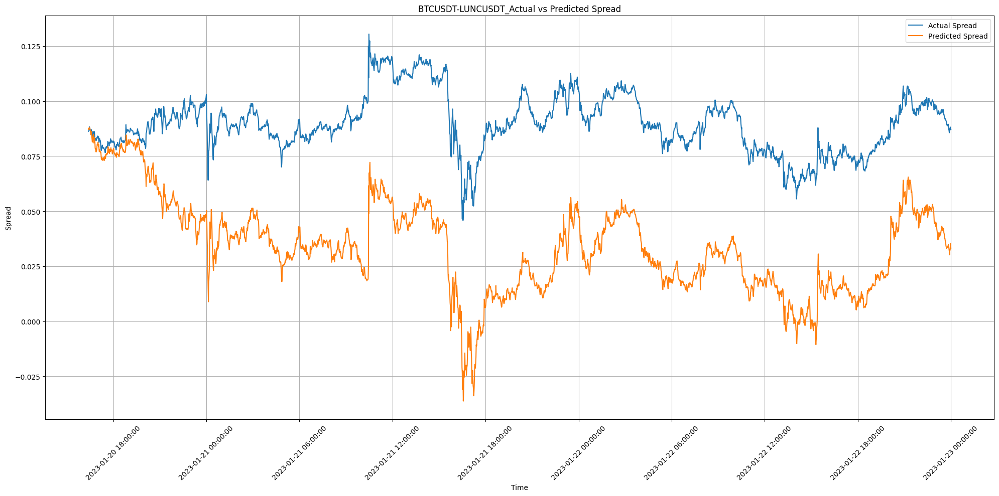

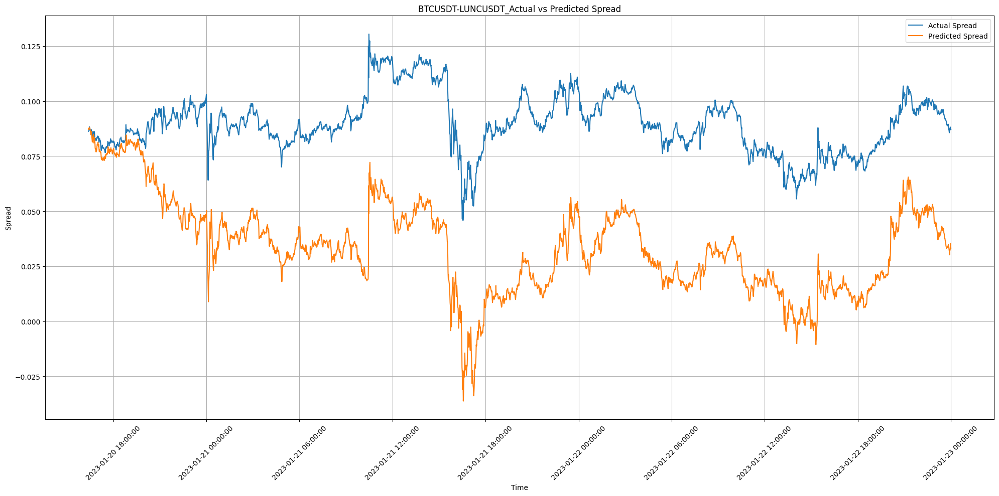

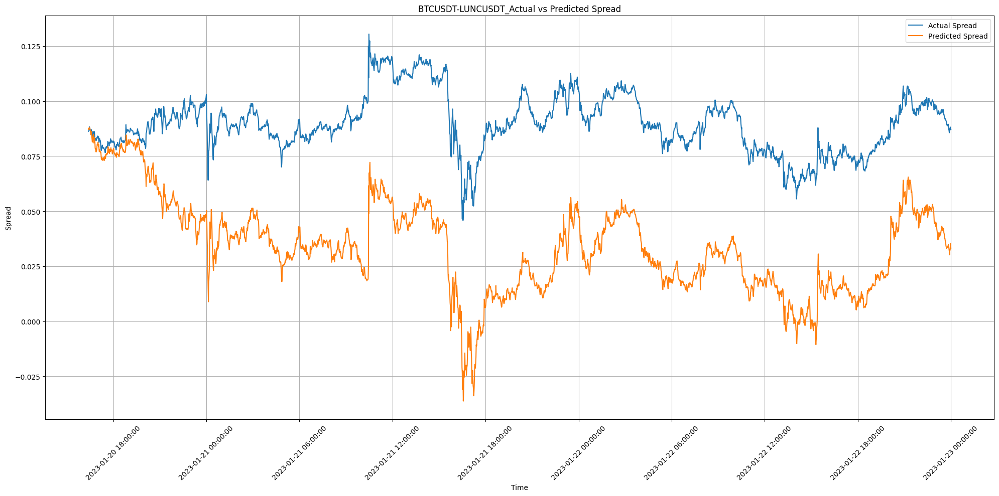

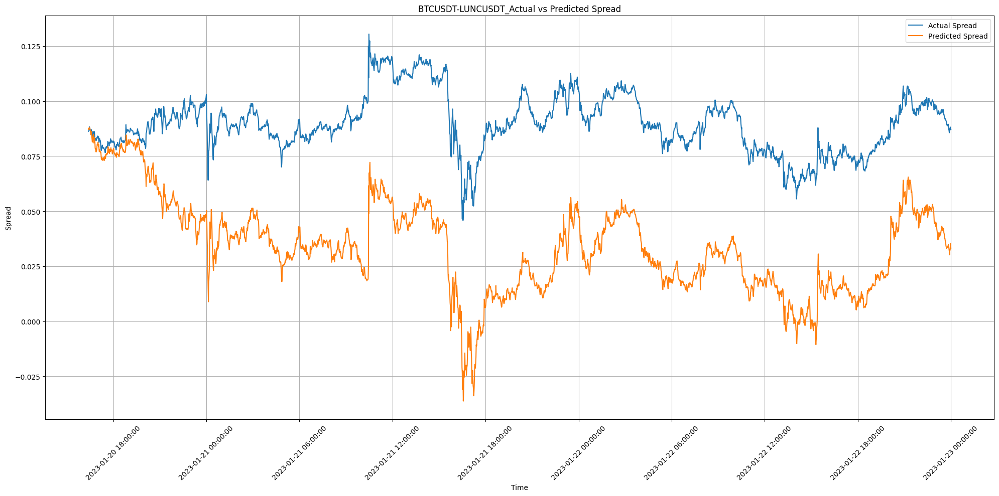

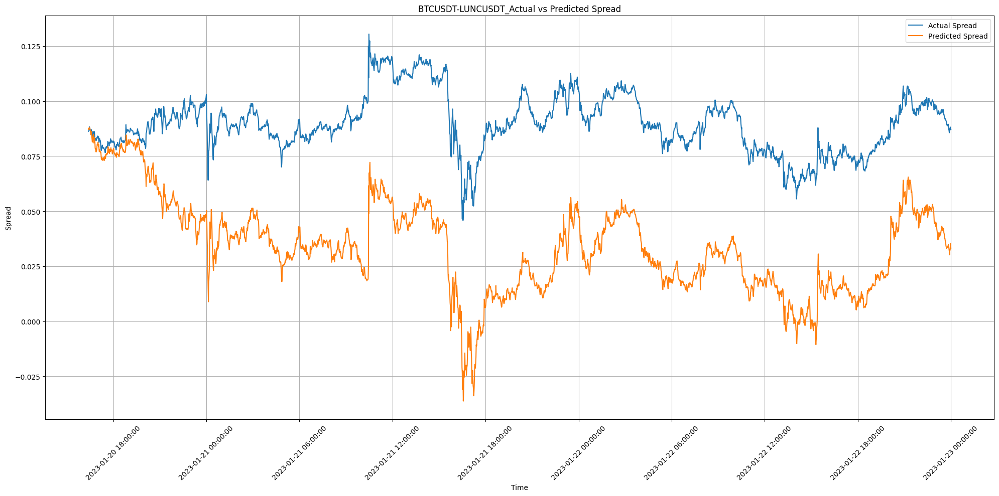

...

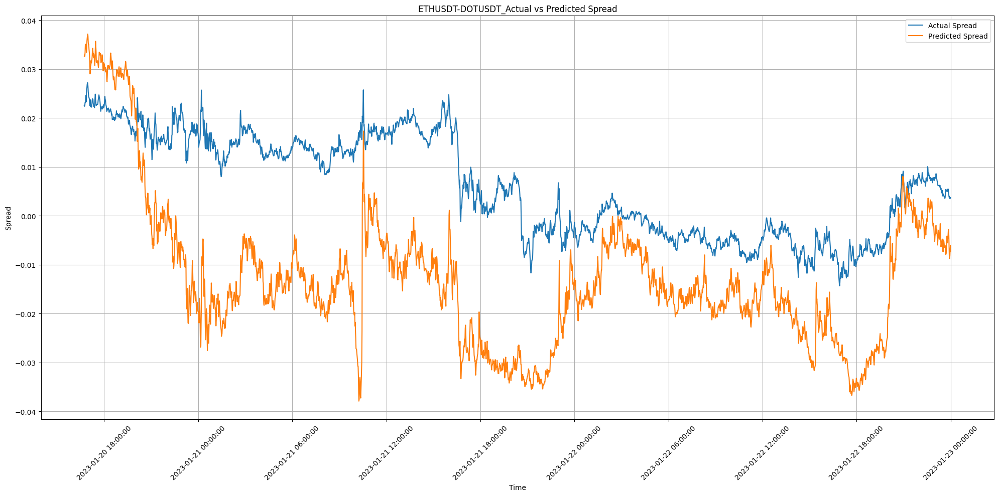

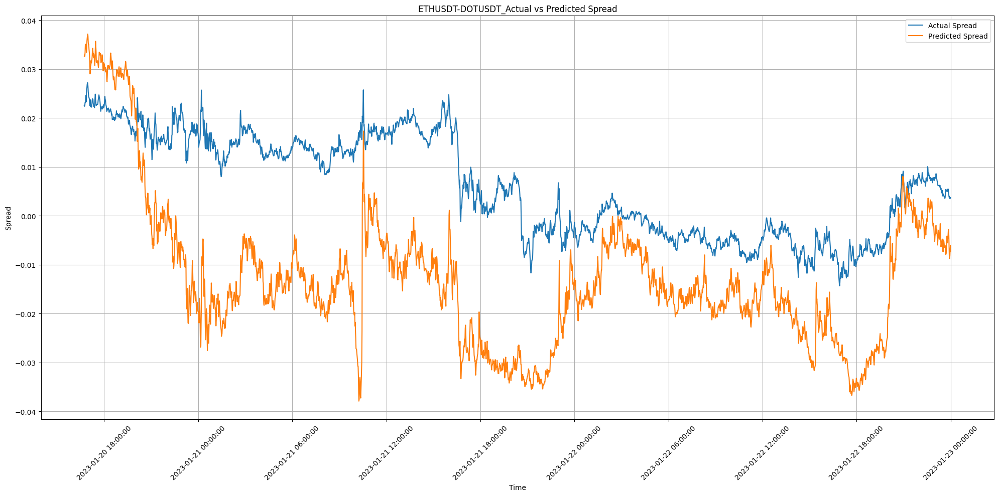

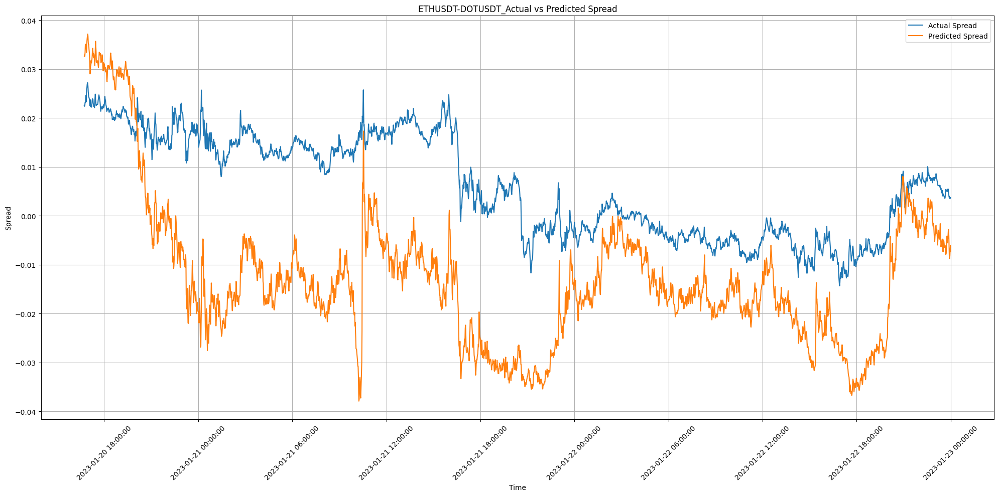

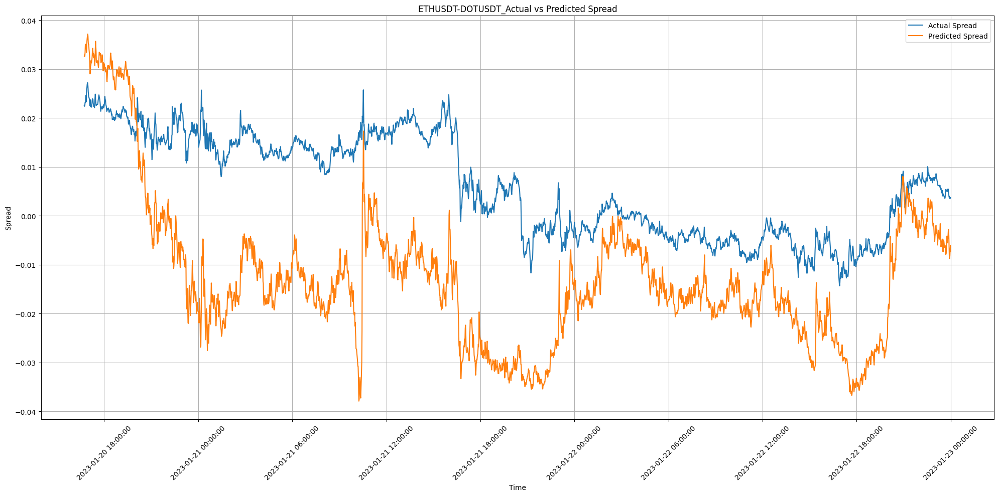

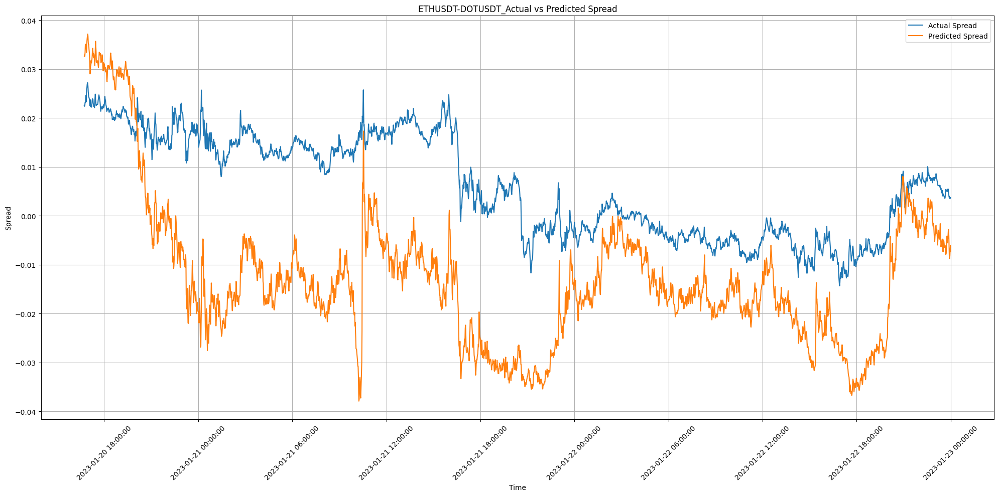

In [ ]:
# Initialize delay and final DataFrame
delay = 1
final_df = pd.DataFrame([])

# Iterate over each row in the pairs DataFrame
for _, row in pairs.iterrows():
    print(f"#######################################################\npair :{row}")
    coin1 = row[0]
    coin2 = row[1]
    beta = row[2]
    alpha = row[3]
    in_sample_start_date = row[4]
    in_sample_end_date = row[5]
    out_of_sample_end_date = row[6]

    # Define the destination folder pattern
    destination_folder_pattern = f'BACKTESTING/{coin1}_{coin2}_{in_sample_start_date}_{in_sample_end_date}_{out_of_sample_end_date}'

    # Find the destination folder matching the pattern
    for folder in glob.glob(f"{destination_folder_pattern}"):
        destination_folder = folder

    # Iterate over each window_d value
    for index, window_d in enumerate(windows_d) :
        print(f"delay : {delay}, window : {window_d}")

        # Initialize metrics dictionary
        metrics_on_predicted_vs_actual_spreads = {}
        metrics_on_predicted_vs_actual_spreads['coin1'] = []
        metrics_on_predicted_vs_actual_spreads['coin2'] = []
        metrics_on_predicted_vs_actual_spreads['window_d'] = []
        metrics_on_predicted_vs_actual_spreads['rmse'] = []
        metrics_on_predicted_vs_actual_spreads['mse'] = []
        metrics_on_predicted_vs_actual_spreads['mae'] = []
        metrics_on_predicted_vs_actual_spreads['r2'] = []
        metrics_on_predicted_vs_actual_spreads['mape'] = []

        # Add coin1, coin2, and window_d to metrics
        metrics_on_predicted_vs_actual_spreads['coin1'].append(coin1)
        metrics_on_predicted_vs_actual_spreads['coin2'].append(coin2)
        metrics_on_predicted_vs_actual_spreads['window_d'].append(window_d)

        # Initialize the SpreadPrediction processor
        processor = SpreadPrediction(
            file1=f'PRICES/PREDICTED/transformers_predictions_{coin1}_{in_sample_end_date}_{out_of_sample_end_date}.csv',
            file2=f'PRICES/PREDICTED/transformers_predictions_{coin2}_{in_sample_end_date}_{out_of_sample_end_date}.csv',
            file3=f'SPREADS/ACTUAL/actual_spread_{coin1}_{coin2}_{in_sample_start_date}_{out_of_sample_end_date}.csv',
            file4=f'PRICES/ACTUAL/test_set_{coin1}_{in_sample_end_date}_{out_of_sample_end_date}.csv',
            file5=f'PRICES/ACTUAL/test_set_{coin2}_{in_sample_end_date}_{out_of_sample_end_date}.csv',
            beta = beta,
            alpha = alpha,
            window = 60,
            standard_threshold = standard_threshold,
            high_threshold = high_threshold,
            initial_capital = initial_capital,
            entry_volume_ratio = entry_volume_ratio,
            cost_ratio = cost_ratio,
            risk_free_rate = risk_free_rate,
            window_d = window_d,
            exit_score = exit_score,
            delay = delay,
            in_sample_start_date=in_sample_start_date,
            in_sample_end_date=in_sample_end_date,
            out_of_sample_end_date= out_of_sample_end_date)

        # Load data and calculate necessary metrics
        processor.load_data()
        processor.calculate_log_prices()
        processor.calculate_predicted_and_actual_spread()
        processor.calculate_predicted_spread_rolling_z_score()
        processor.add_historical_spread_rolling_z_score()
        processor.evaluate_and_plot_predicted_and_actual_spread()

        # Add calculated metrics to the dictionary
        metrics_on_predicted_vs_actual_spreads['rmse'].append(processor.rmse )
        metrics_on_predicted_vs_actual_spreads['mse'].append(processor.mse )
        metrics_on_predicted_vs_actual_spreads['mae'].append(processor.mae )
        metrics_on_predicted_vs_actual_spreads['r2'].append(processor.r2 )
        metrics_on_predicted_vs_actual_spreads['mape'].append(processor.mape )

        # Process historical mid prices and calculate rolling statistics
        processor.add_historical_mid_prices()
        processor.calculate_rolling_statistics_on_historical_spread()

        # Generate trading signals for predicted spread and execute trades
        processor.generate_trading_signals_for_predicted_spread()
        processor.execute_trades(processor.ai_algo_trading_signals, 'ai_algo')

        # Add AI algorithm trading metrics to the dictionary
        metrics_on_predicted_vs_actual_spreads['ai_algo-cumulative_return'] = processor.metrics['ai_algo']['cumulative_return']
        metrics_on_predicted_vs_actual_spreads['ai_algo-annualized_return'] = processor.metrics['ai_algo']['annualized_return']
        metrics_on_predicted_vs_actual_spreads['ai_algo-annualized_volatility'] = processor.metrics['ai_algo']['annualized_volatility']
        metrics_on_predicted_vs_actual_spreads['ai_algo-sharpe_ratio'] = processor.metrics['ai_algo']['sharpe_ratio']
        metrics_on_predicted_vs_actual_spreads['ai_algo-raw_pnl'] = processor.metrics['ai_algo']['raw_pnl']
        metrics_on_predicted_vs_actual_spreads['ai_algo-net_pnl'] = processor.metrics['ai_algo']['net_pnl']
        metrics_on_predicted_vs_actual_spreads['ai_algo-fees'] = processor.metrics['ai_algo']['fees']
        metrics_on_predicted_vs_actual_spreads['ai_algo-ratio_fees'] = processor.metrics['ai_algo']['ratio_fees']
        metrics_on_predicted_vs_actual_spreads['ai_algo-num_trades'] = processor.metrics['ai_algo']['num_trades']
        metrics_on_predicted_vs_actual_spreads['ai_algo-avg_trade_duration'] = processor.metrics['ai_algo']['avg_trade_duration']
        metrics_on_predicted_vs_actual_spreads['ai_algo-win_ratio'] = processor.metrics['ai_algo']['win_ratio']
        metrics_on_predicted_vs_actual_spreads['ai_algo-max_drawdown'] = processor.metrics['ai_algo']['max_drawdown']

        # Generate trading signals for historical spread and execute trades
        processor.add_historical_rolling_sd_percentile_75th()
        processor.generate_trading_signals_for_historical_spread()
        processor.execute_trades(processor.standard_algo_trading_signals,'standard_algo')

        # Add standard algorithm trading metrics to the dictionary
        metrics_on_predicted_vs_actual_spreads['standard_algo-cumulative_return'] = processor.metrics['standard_algo']['cumulative_return']
        metrics_on_predicted_vs_actual_spreads['standard_algo-annualized_return'] = processor.metrics['standard_algo']['annualized_return']
        metrics_on_predicted_vs_actual_spreads['standard_algo-annualized_volatility'] = processor.metrics['standard_algo']['annualized_volatility']
        metrics_on_predicted_vs_actual_spreads['standard_algo-sharpe_ratio'] = processor.metrics['standard_algo']['sharpe_ratio']
        metrics_on_predicted_vs_actual_spreads['standard_algo-raw_pnl'] = processor.metrics['standard_algo']['raw_pnl']
        metrics_on_predicted_vs_actual_spreads['standard_algo-net_pnl'] = processor.metrics['standard_algo']['net_pnl']
        metrics_on_predicted_vs_actual_spreads['standard_algo-fees'] = processor.metrics['standard_algo']['fees']
        metrics_on_predicted_vs_actual_spreads['standard_algo-ratio_fees'] = processor.metrics['standard_algo']['ratio_fees']
        metrics_on_predicted_vs_actual_spreads['standard_algo-num_trades'] = processor.metrics['standard_algo']['num_trades']
        metrics_on_predicted_vs_actual_spreads['standard_algo-avg_trade_duration'] = processor.metrics['standard_algo']['avg_trade_duration']
        metrics_on_predicted_vs_actual_spreads['standard_algo-win_ratio'] = processor.metrics['standard_algo']['win_ratio']
        metrics_on_predicted_vs_actual_spreads['standard_algo-max_drawdown'] = processor.metrics['standard_algo']['max_drawdown']

        # Export the results to CSV files
        processor.export_to_csv()

        # Create a temporary DataFrame for the current metrics and concatenate it with the final DataFrame
        tmp_df = pd.DataFrame(metrics_on_predicted_vs_actual_spreads)
        final_df = pd.concat([final_df, tmp_df], axis = 0)

        # Save the final DataFrame to a CSV file
        print(f"create back_testing_metrics.csv ")
        final_df.to_csv(f'BACKTESTING/back_testing_results.csv', index = False)


# Get statistical properties from the predicted spread : cointegration, correlation, hurst exponent, half life

In [8]:
# List of cointegrated pairs
pairs = cointegrated_pairs[['coin1', 'coin2','in_sample_start_date','in_sample_end_date','out_of_sample_end_date']]
pairs

,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date
0,BTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23
1,ETHUSDT,XRPUSDT,2023-01-01,2023-01-19,2023-01-23
2,ETHUSDT,SHIBUSDT,2023-01-01,2023-01-19,2023-01-23
3,ETHUSDT,MATICUSDT,2023-01-01,2023-01-19,2023-01-23
4,ETHUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23
5,SOLUSDT,SANDUSDT,2023-01-01,2023-01-19,2023-01-23
6,SOLUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23
7,XRPUSDT,LTCUSDT,2023-01-01,2023-01-19,2023-01-23
8,XRPUSDT,MATICUSDT,2023-01-01,2023-01-19,2023-01-23
9,XRPUSDT,SANDUSDT,2023-01-01,2023-01-19,2023-01-23


In [9]:
def adf_test( series):
  """
  Perform Augmented Dickey-Fuller test on a given time series.

  Parameters:
  ----------
  series : pandas.Series
      The time series to test.

  Returns:
  -------
  float
      The p-value of the ADF test.
  """
  # Handle missing and infinite values
  series = series.replace([np.inf, -np.inf], np.nan).dropna()
  result = adfuller(series,autolag = 'BIC')
  return result[1]

def correlation_func(spread_coin1,spread_coin2):
    """
    Calculate the Pearson correlation between two spreads.

    Parameters:
    ----------
    spread_coin1 : pandas.Series
        The first spread series.
    spread_coin2 : pandas.Series
        The second spread series.

    Returns:
    -------
    tuple
        The correlation coefficient and the p-value.
    """
    correlation, correlation_p_value = pearsonr(spread_coin1, spread_coin2)
    return correlation, correlation_p_value

def calculate_half_life(spread):
    """
    Calculate the half-life of mean reversion for a given spread.

    Parameters:
    ----------
    spread : pandas.Series
        The spread series.

    Returns:
    -------
    float
        The half-life of mean reversion.
    """
    df_spread = spread.to_frame()
    df_spread.columns = ['spread']
    spread_lag = df_spread.spread.shift(1)
    spread_lag.iloc[0] = spread_lag.iloc[1]
    spread_ret = df_spread.spread - spread_lag
    spread_ret.iloc[0] = spread_ret.iloc[1]
    spread_lag2 = sm.add_constant(spread_lag)
    model = sm.OLS(spread_ret, spread_lag2)
    res = model.fit()
    halflife = round(-np.log(2) / res.params[1], 0)
    return halflife

def calculate_hurst(spread):
    """
    Calculate the Hurst exponent of a given spread.

    Parameters:
    ----------
    spread : pandas.Series
        The spread series.

    Returns:
    -------
    float
        The Hurst exponent.
    """
    # Create the range of lag values
    lags = range(2, 100)
    ts = spread.values

    # Calculate the array of the variances of the lagged differences
    tau = [np.sqrt(np.std(np.subtract(ts[lag:], ts[:-lag]))) for lag in lags]

    # Avoid divide by zero in log
    tau = np.array(tau)
    tau = np.where(tau == 0, np.finfo(float).eps, tau)

    # Use a linear fit to estimate the Hurst Exponent
    poly = np.polyfit(np.log(lags), np.log(tau), 1)

    # Return the Hurst exponent from the polyfit output
    hurst = poly[0] * 2.0
    return hurst

def calculate_error_metrics(pred_spreads, actual_spreads):
  """
  Calculate various error metrics between predicted and actual spreads.

  Parameters:
  ----------
  pred_spreads : pandas.Series
      The predicted spread series.
  actual_spreads : pandas.Series
      The actual spread series.

  Returns:
  -------
  tuple
      RMSE, MSE, MAE, R2, MAPE
  """
  rmse = np.sqrt(mean_squared_error(pred_spreads, actual_spreads))
  mse = mean_squared_error(pred_spreads, actual_spreads)
  mae = mean_absolute_error(pred_spreads, actual_spreads)
  r2 = r2_score(pred_spreads, actual_spreads)
  mape = mean_absolute_percentage_error(pred_spreads, actual_spreads)
  return rmse, mse, mae, r2, mape

# Initialize dictionaries for statistical properties and error metrics
predicted_spreads_statistical_properties = {}
predicted_spreads_statistical_properties['coin1'] = []
predicted_spreads_statistical_properties['coin2'] = []
predicted_spreads_statistical_properties['in_sample_start_date'] = []
predicted_spreads_statistical_properties['in_sample_end_date'] = []
predicted_spreads_statistical_properties['out_of_sample_end_date'] = []
predicted_spreads_statistical_properties['adf_p_value'] = []
predicted_spreads_statistical_properties['adf_p_value'] = []
predicted_spreads_statistical_properties['correlation'] = []
predicted_spreads_statistical_properties['correlation_p_value'] = []
predicted_spreads_statistical_properties['hurst'] = []
predicted_spreads_statistical_properties['half_life'] = []

actual_spreads_statistical_properties = {}
actual_spreads_statistical_properties['coin1'] = []
actual_spreads_statistical_properties['coin2'] = []
actual_spreads_statistical_properties['in_sample_start_date'] = []
actual_spreads_statistical_properties['in_sample_end_date'] = []
actual_spreads_statistical_properties['out_of_sample_end_date'] = []
actual_spreads_statistical_properties['adf_p_value'] = []
actual_spreads_statistical_properties['adf_p_value'] = []
actual_spreads_statistical_properties['correlation'] = []
actual_spreads_statistical_properties['correlation_p_value'] = []
actual_spreads_statistical_properties['hurst'] = []
actual_spreads_statistical_properties['half_life'] = []

error_metrics = {}
error_metrics['coin1'] = []
error_metrics['coin2'] = []
error_metrics['in_sample_start_date'] = []
error_metrics['in_sample_end_date'] = []
error_metrics['out_of_sample_end_date'] = []
error_metrics['rmse'] = []
error_metrics['mse'] = []
error_metrics['mae'] = []
error_metrics['r2'] = []
error_metrics['mape'] = []

# Iterate over each row in the pairs DataFrame
for _, row in pairs.iterrows():
    print(f"#######################################################\npair :{row}")
    coin1 = row[0]
    coin2 = row[1]
    in_sample_start_date = row[2]
    in_sample_end_date = row[3]
    out_of_sample_end_date = row[4]
    destination_folder_pattern = f'BACKTESTING/{coin1}_{coin2}_{in_sample_start_date}_{in_sample_end_date}_{out_of_sample_end_date}'

    # Find the destination folder matching the pattern
    for folder in glob.glob(f"{destination_folder_pattern}"):
        destination_folder = folder
        print(f"folder : {destination_folder}")
        files = os.listdir(destination_folder)
        for file in files:
          if file.startswith(f"ai_algo_trading_data_{coin1}_{coin2}_{in_sample_end_date}_{out_of_sample_end_date}"):
            file = os.path.join(destination_folder, file)
            print(f"file : {file}")
            df = pd.read_csv(file)
            df = df[['close_time','predicted_spread', 'actual_spread', f'predictions_{coin1}', f'predictions_{coin2}',f'actual_{coin1}',f'actual_{coin2}']]
            df = df.dropna()

            # Calculate and store predicted spread statistics
            adf_p_value = adf_test(df['predicted_spread'])
            correlation, correlation_p_value = correlation_func(df[f'predictions_{coin1}'],df[f'predictions_{coin2}'])
            # plot_predicted_vs_actual_spreads(df,'predicted_spread','actual_spread', coin1,coin2)
            half_life = calculate_half_life(df['predicted_spread'])
            hurst = calculate_hurst(df['predicted_spread'])
            predicted_spreads_statistical_properties['coin1'].append(coin1)
            predicted_spreads_statistical_properties['coin2'].append(coin2)
            predicted_spreads_statistical_properties['in_sample_start_date'].append(in_sample_start_date)
            predicted_spreads_statistical_properties['in_sample_end_date'].append(in_sample_end_date)
            predicted_spreads_statistical_properties['out_of_sample_end_date'].append(out_of_sample_end_date)
            predicted_spreads_statistical_properties['adf_p_value'].append(adf_p_value)
            predicted_spreads_statistical_properties['correlation'].append(correlation)
            predicted_spreads_statistical_properties['correlation_p_value'].append(correlation_p_value)
            predicted_spreads_statistical_properties['hurst'].append(hurst)
            predicted_spreads_statistical_properties['half_life'].append(half_life)

            # Calculate and store actual spread statistics
            adf_p_value = adf_test(df['actual_spread'])
            correlation, correlation_p_value = correlation_func(df[f'actual_{coin1}'],df[f'actual_{coin2}'])
            half_life = calculate_half_life(df['actual_spread'])
            hurst = calculate_hurst(df['actual_spread'])
            actual_spreads_statistical_properties['coin1'].append(coin1)
            actual_spreads_statistical_properties['coin2'].append(coin2)
            actual_spreads_statistical_properties['in_sample_start_date'].append(in_sample_start_date)
            actual_spreads_statistical_properties['in_sample_end_date'].append(in_sample_end_date)
            actual_spreads_statistical_properties['out_of_sample_end_date'].append(out_of_sample_end_date)
            actual_spreads_statistical_properties['adf_p_value'].append(adf_p_value)
            actual_spreads_statistical_properties['correlation'].append(correlation)
            actual_spreads_statistical_properties['correlation_p_value'].append(correlation_p_value)
            actual_spreads_statistical_properties['hurst'].append(hurst)
            actual_spreads_statistical_properties['half_life'].append(half_life)

            # Calculate and store error metrics
            rmse, mse, mae, r2, mape = calculate_error_metrics(df['predicted_spread'],df['actual_spread'])
            error_metrics['coin1'].append(coin1)
            error_metrics['coin2'].append(coin2)
            error_metrics['in_sample_start_date'].append(in_sample_start_date)
            error_metrics['in_sample_end_date'].append(in_sample_end_date)
            error_metrics['out_of_sample_end_date'].append(out_of_sample_end_date)
            error_metrics['rmse'].append(rmse)
            error_metrics['mse'].append(mse)
            error_metrics['mae'].append(mae)
            error_metrics['r2'].append(r2)
            error_metrics['mape'].append(mape)

            break
# Convert dictionaries to DataFrames and save to CSV
predicted_spreads_statistical_properties_df = pd.DataFrame(predicted_spreads_statistical_properties).sort_values(by=['in_sample_start_date','coin1'], ascending = True)
predicted_spreads_statistical_properties_df.to_csv(f'SPREADS/PREDICTED/predicted_spreads-statistical_properties.csv', index = False)

actual_spreads_statistical_properties_df = pd.DataFrame(actual_spreads_statistical_properties).sort_values(by=['in_sample_start_date','coin1'], ascending = True)
actual_spreads_statistical_properties_df.to_csv(f'SPREADS/ACTUAL/actual_spreads-statistical_properties.csv', index = False)

error_metrics_df = pd.DataFrame(error_metrics).sort_values(by=['in_sample_start_date','coin1'], ascending = True)
error_metrics_df.to_csv(f'SPREADS/PREDICTED/pred_vs_actual_error_metrics.csv', index = False)


#######################################################
pair :coin1                        BTCUSDT
coin2                       LUNCUSDT
in_sample_start_date      2023-01-01
in_sample_end_date        2023-01-19
out_of_sample_end_date    2023-01-23
Name: 0, dtype: object
folder : BACKTESTING/BTCUSDT_LUNCUSDT_2023-01-01_2023-01-19_2023-01-23
file : BACKTESTING/BTCUSDT_LUNCUSDT_2023-01-01_2023-01-19_2023-01-23/ai_algo_trading_data_BTCUSDT_LUNCUSDT_2023-01-19_2023-01-23_1440min_window_1min_delay.csv
#######################################################
pair :coin1                        ETHUSDT
coin2                        XRPUSDT
in_sample_start_date      2023-01-01
in_sample_end_date        2023-01-19
out_of_sample_end_date    2023-01-23
Name: 1, dtype: object
folder : BACKTESTING/ETHUSDT_XRPUSDT_2023-01-01_2023-01-19_2023-01-23
file : BACKTESTING/ETHUSDT_XRPUSDT_2023-01-01_2023-01-19_2023-01-23/ai_algo_trading_data_ETHUSDT_XRPUSDT_2023-01-19_2023-01-23_360min_window_1min_delay.csv
####

In [10]:
predicted_spreads_statistical_properties_df

,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date,adf_p_value,correlation,correlation_p_value,hurst,half_life
17,ADAUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00099613424705532181,0.75258003730323497216,0.00000000000000000000,0.41912156321331434095,81.00000000000000000000
0,BTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00666775280660605440,0.66894778449671166154,0.00000000000000000000,0.44187852642775821144,139.00000000000000000000
13,DOGEUSDT,LINKUSDT,2023-01-01,2023-01-19,2023-01-23,0.06149471707351607253,0.81134185014575999073,0.00000000000000000000,0.48350024151552850604,169.00000000000000000000
25,DOTUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.04611042612766780985,0.94657131409913586317,0.00000000000000000000,0.30857846822193746306,46.00000000000000000000
1,ETHUSDT,XRPUSDT,2023-01-01,2023-01-19,2023-01-23,0.05870776203250921421,0.23080825133585386455,0.00000000000000000000,0.37956781484639784408,112.00000000000000000000
2,ETHUSDT,SHIBUSDT,2023-01-01,2023-01-19,2023-01-23,0.05585561711727556750,0.21060785891291150529,0.00000000000000000000,0.28858359393819349448,37.00000000000000000000
3,ETHUSDT,MATICUSDT,2023-01-01,2023-01-19,2023-01-23,0.08460501988125879169,-0.05042840557327935014,0.00367139155223550687,0.44568420542875275547,252.00000000000000000000
4,ETHUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.00517662888090992656,0.40060832206744928508,0.00000000000000000000,0.38509730938345393403,127.00000000000000000000
23,LINKUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.02220657637504154513,0.68760824991013080876,0.00000000000000000000,0.42513874930891804027,134.00000000000000000000
24,LINKUSDT,ATOMUSDT,2023-01-01,2023-01-19,2023-01-23,0.01643823908077894289,0.89542909954231908465,0.00000000000000000000,0.38778757562937349324,88.00000000000000000000


In [11]:
actual_spreads_statistical_properties_df

,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date,adf_p_value,correlation,correlation_p_value,hurst,half_life
17,ADAUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00369562341684385488,0.78417283644993474034,0.00000000000000000000,0.44599667521794644776,96.00000000000000000000
0,BTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00225648170052655675,0.81079754049913299596,0.00000000000000000000,0.44070514336531030342,102.00000000000000000000
13,DOGEUSDT,LINKUSDT,2023-01-01,2023-01-19,2023-01-23,0.07204787388716681062,0.85086035342289212391,0.00000000000000000000,0.48976277288437347623,223.00000000000000000000
25,DOTUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.00004936884406812490,0.95287443893220213909,0.00000000000000000000,0.35085502344476393599,64.00000000000000000000
1,ETHUSDT,XRPUSDT,2023-01-01,2023-01-19,2023-01-23,0.00512746687698669400,0.92676218777132957083,0.00000000000000000000,0.34613323921055155763,95.00000000000000000000
2,ETHUSDT,SHIBUSDT,2023-01-01,2023-01-19,2023-01-23,0.00189063402506112351,0.84637801177577898226,0.00000000000000000000,0.37140870794619634809,78.00000000000000000000
3,ETHUSDT,MATICUSDT,2023-01-01,2023-01-19,2023-01-23,0.05683227510524976878,0.90216260940165704518,0.00000000000000000000,0.39165500126661911828,188.00000000000000000000
4,ETHUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.12419706652426637516,0.71085899571565824839,0.00000000000000000000,0.37110540448618417608,243.00000000000000000000
23,LINKUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.04330708862064765186,0.70036575195967731844,0.00000000000000000000,0.44825056574405380827,155.00000000000000000000
24,LINKUSDT,ATOMUSDT,2023-01-01,2023-01-19,2023-01-23,0.00723013186146525058,0.86153195035909835298,0.00000000000000000000,0.42457168528056377088,134.00000000000000000000


In [12]:
pred_vs_actual_error_metrics = pd.read_csv(f'SPREADS/PREDICTED/pred_vs_actual_error_metrics.csv')
pred_vs_actual_error_metrics.head()

,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date,rmse,mse,mae,r2,mape
0,ADAUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.01587329506744960053,0.00025196149629830002,0.01172128121058580059,0.36910458622790298655,4.93419540341765383573
1,BTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.05846912171619370047,0.00341863819426300010,0.05589028690771070257,-6.86916044170355455378,6.09090419606292332588
2,DOGEUSDT,LINKUSDT,2023-01-01,2023-01-19,2023-01-23,0.00894368717891170020,0.00007998954035423093,0.00872247087209930029,0.36833867845018247733,0.70651515390577368514
3,DOTUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.00680140346440280021,0.00004625908908559081,0.00590557901733909998,0.09692495246645309315,0.18023014601456718853
4,ETHUSDT,XRPUSDT,2023-01-01,2023-01-19,2023-01-23,0.01241472234872030046,0.00015412533099579999,0.01165264462001480011,-0.90546559015519478830,2.45517493954055154859


In [13]:
most_cointegrated_pred_spreads = predicted_spreads_statistical_properties_df[(predicted_spreads_statistical_properties_df['adf_p_value'] <= 0.05) & (predicted_spreads_statistical_properties_df['correlation'] > 0.7)  & (predicted_spreads_statistical_properties_df['hurst'] < 0.5)]
most_cointegrated_pred_spreads


,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date,adf_p_value,correlation,correlation_p_value,hurst,half_life
17,ADAUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00099613424705532181,0.75258003730323497216,0.00000000000000000000,0.41912156321331434095,81.00000000000000000000
25,DOTUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.04611042612766780985,0.94657131409913586317,0.00000000000000000000,0.30857846822193746306,46.00000000000000000000
24,LINKUSDT,ATOMUSDT,2023-01-01,2023-01-19,2023-01-23,0.01643823908077894289,0.89542909954231908465,0.00000000000000000000,0.38778757562937349324,88.00000000000000000000
15,LTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.01929844756080845158,0.72028623123165935738,0.00000000000000000000,0.38877388843918714301,128.00000000000000000000
19,NEARUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00245619324182402583,0.83420586661110740501,0.00000000000000000000,0.42027057265028472388,75.00000000000000000000
21,SANDUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.04935292818458604513,0.76524676863308349617,0.00000000000000000000,0.38279947241990053275,139.00000000000000000000
22,SANDUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.02495630422048155175,0.74303105935740232368,0.00000000000000000000,0.41269180726462623143,191.00000000000000000000
5,SOLUSDT,SANDUSDT,2023-01-01,2023-01-19,2023-01-23,0.00771395312606663539,0.93053857832192876653,0.00000000000000000000,0.41627654356609672393,177.00000000000000000000
6,SOLUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.00382617341976177134,0.88242447904007448312,0.00000000000000000000,0.35284163359356635059,80.00000000000000000000
7,XRPUSDT,LTCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00195514565616141094,0.85134514815207418259,0.00000000000000000000,0.39687739763585061503,75.00000000000000000000


In [15]:
pred_vs_actual_error_metrics_ordered_mae = pred_vs_actual_error_metrics.copy()
pred_vs_actual_error_metrics_ordered_mae= pred_vs_actual_error_metrics_ordered_mae.merge(most_cointegrated_pred_spreads, on=['coin1', 'coin2','in_sample_start_date','in_sample_end_date','out_of_sample_end_date'], how='inner')
pred_vs_actual_error_metrics_ordered_mae = pred_vs_actual_error_metrics_ordered_mae.sort_values(by=['mae','adf_p_value','correlation'], ascending=[True, True, False])
pred_vs_actual_error_metrics_ordered_mae.to_csv(f'EXPLORATIVE_DATA_ANALYSIS/scope.csv', index = False)
pred_vs_actual_error_metrics_ordered_mae

,coin1,coin2,in_sample_start_date,in_sample_end_date,out_of_sample_end_date,rmse,mse,mae,r2,mape,adf_p_value,correlation,correlation_p_value,hurst,half_life
2,LINKUSDT,ATOMUSDT,2023-01-01,2023-01-19,2023-01-23,0.00377789822154810020,0.00001427251497237675,0.00278796294405520007,0.78660744013019268106,0.62726020446510855066,0.01643823908077894289,0.89542909954231908465,0.00000000000000000000,0.38778757562937349324,88.00000000000000000000
10,XRPUSDT,TRXUSDT,2023-01-01,2023-01-19,2023-01-23,0.00727230121133210037,0.00005288636490834242,0.00579934113801050012,-1.54162186413696256082,0.14892801589451121203,0.03536386793756667035,0.73377545640566055329,0.00000000000000000000,0.30680807456923325782,63.00000000000000000000
1,DOTUSDT,JASMYUSDT,2023-01-01,2023-01-19,2023-01-23,0.00680140346440280021,0.00004625908908559081,0.00590557901733909998,0.09692495246645309315,0.18023014601456718853,0.04611042612766780985,0.94657131409913586317,0.00000000000000000000,0.30857846822193746306,46.00000000000000000000
3,LTCUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.00699531453825659975,0.00004893442548914428,0.00618570471245909973,0.72929932895663296399,3.54179006430946108352,0.01929844756080845158,0.72028623123165935738,0.00000000000000000000,0.38877388843918714301,128.00000000000000000000
4,NEARUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.01595175568639129945,0.00025445850947829998,0.00999179300343100082,0.65995560916060003187,0.29298718444456589571,0.00245619324182402583,0.83420586661110740501,0.00000000000000000000,0.42027057265028472388,75.00000000000000000000
9,XRPUSDT,LTCUSDT,2023-01-01,2023-01-19,2023-01-23,0.01249812662034649989,0.00015620316901820001,0.01081115915695799942,-4.39036712652736493823,0.37612186455081569880,0.00195514565616141094,0.85134514815207418259,0.00000000000000000000,0.39687739763585061503,75.00000000000000000000
8,SOLUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.01407048282990290035,0.00019797848706650000,0.01138454403270530019,0.67450422606609428122,0.83500868372014414032,0.00382617341976177134,0.88242447904007448312,0.00000000000000000000,0.35284163359356635059,80.00000000000000000000
0,ADAUSDT,LUNCUSDT,2023-01-01,2023-01-19,2023-01-23,0.01587329506744960053,0.00025196149629830002,0.01172128121058580059,0.36910458622790298655,4.93419540341765383573,0.00099613424705532181,0.75258003730323497216,0.00000000000000000000,0.41912156321331434095,81.00000000000000000000
5,SANDUSDT,DOTUSDT,2023-01-01,2023-01-19,2023-01-23,0.05784100628374760217,0.00334558200791650008,0.05342309994312310212,-3.06756527148455315768,11.13807644787125639141,0.04935292818458604513,0.76524676863308349617,0.00000000000000000000,0.38279947241990053275,139.00000000000000000000
7,SOLUSDT,SANDUSDT,2023-01-01,2023-01-19,2023-01-23,0.06702013529658899793,0.00449169853517300023,0.06044840516352979753,-13.29991069683165783033,5.09220754881422177363,0.00771395312606663539,0.93053857832192876653,0.00000000000000000000,0.41627654356609672393,177.00000000000000000000
